In [ ]:
# Use Yahoo Finance API for historical data. We'll fetch data from 2015 to the present.
import yfinance as yf
import pandas as pd

In [ ]:
# Fetch Coca-Cola stock data
ticker = 'KO' # Coca-Cola stock ticker
data = yf.download(ticker, start='2015-01-01',
end='2023-12-31')

[*********************100%***********************]  1 of 1 completed


In [ ]:
# Reset index for easier handling
data.reset_index(inplace=True)

In [ ]:
# Display data structure
print(data.info())
print(data.head())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2264 entries, 0 to 2263
Data columns (total 6 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   (Date, )      2264 non-null   datetime64[ns]
 1   (Close, KO)   2264 non-null   float64       
 2   (High, KO)    2264 non-null   float64       
 3   (Low, KO)     2264 non-null   float64       
 4   (Open, KO)    2264 non-null   float64       
 5   (Volume, KO)  2264 non-null   int64         
dtypes: datetime64[ns](1), float64(4), int64(1)
memory usage: 106.3 KB
None
Price        Date      Close       High        Low       Open    Volume
Ticker                    KO         KO         KO         KO        KO
0      2015-01-02  29.992603  30.177656  29.750613  30.078011   9921100
1      2015-01-05  29.992603  30.583346  29.949901  30.384058  26292600
2      2015-01-06  30.220350  30.561984  30.063770  30.184764  16897500
3      2015-01-07  30.597569  30.682976  30.305757  30.462

In [ ]:
# Check for missing values
print(data.isnull().sum())

# Fill missing numerical values with the column mean
data.fillna(method='ffill', inplace=True) # Forward fill for stock data continuity
data.fillna(0, inplace=True) # Replace remaining missing dividends/splits with 0

# Confirm no missing values remain
print(data.isnull().sum())

Price   Ticker
Date              0
Close   KO        0
High    KO        0
Low     KO        0
Open    KO        0
Volume  KO        0
dtype: int64
Price   Ticker
Date              0
Close   KO        0
High    KO        0
Low     KO        0
Open    KO        0
Volume  KO        0
dtype: int64


In [ ]:
# Add Moving Averages
data['MA_20'] = data['Close'].rolling(window=20).mean()
data['MA_50'] = data['Close'].rolling(window=50).mean()

# Add Daily Returns
data['Daily_Return'] = data['Close'].pct_change()

# Add Volatility (standard deviation of returns over a rolling window)
data['Volatility'] = data['Daily_Return'].rolling(window=20).std()

# Drop rows with NA due to rolling calculations
data.dropna(inplace=True)

print(data.head())

Price        Date      Close       High        Low       Open    Volume  \
Ticker                    KO         KO         KO         KO        KO   
49     2015-03-16  28.913836  28.956892  28.698543  28.705718  15238800   
50     2015-03-17  29.071703  29.229585  28.935352  29.186526  21661800   
51     2015-03-18  29.136293  29.272647  28.562180  29.050177  26247500   
52     2015-03-19  28.720064  29.078886  28.677005  29.050179  16057600   
53     2015-03-20  29.172173  29.179348  28.712879  28.755939  31608500   

Price       MA_20      MA_50 Daily_Return Volatility  
Ticker                                                
49      29.748193  29.998751     0.009522   0.011377  
50      29.713891  29.980333     0.005460   0.011464  
51      29.685667  29.963207     0.002222   0.011486  
52      29.623108  29.933201    -0.014286   0.011604  
53      29.588136  29.904693     0.015742   0.012260  


In [ ]:
# Summary statistics
print(data.describe())

Price                            Date        Close         High          Low  \
Ticker                                          KO           KO           KO   
count                            2215  2215.000000  2215.000000  2215.000000   
mean    2019-08-06 07:49:22.889390592    42.048377    42.337400    41.754463   
min               2015-03-16 00:00:00    27.488174    27.872289    26.453481   
25%               2017-05-24 12:00:00    33.936785    34.151408    33.717882   
50%               2019-08-07 00:00:00    39.998833    40.339886    39.651799   
75%               2021-10-16 12:00:00    49.775476    50.087511    49.514115   
max               2023-12-29 00:00:00    59.625160    60.516687    59.396645   
std                               NaN     9.340581     9.416087     9.259001   

Price          Open        Volume        MA_20        MA_50 Daily_Return  \
Ticker           KO            KO                                          
count   2215.000000  2.215000e+03  2215.000000 

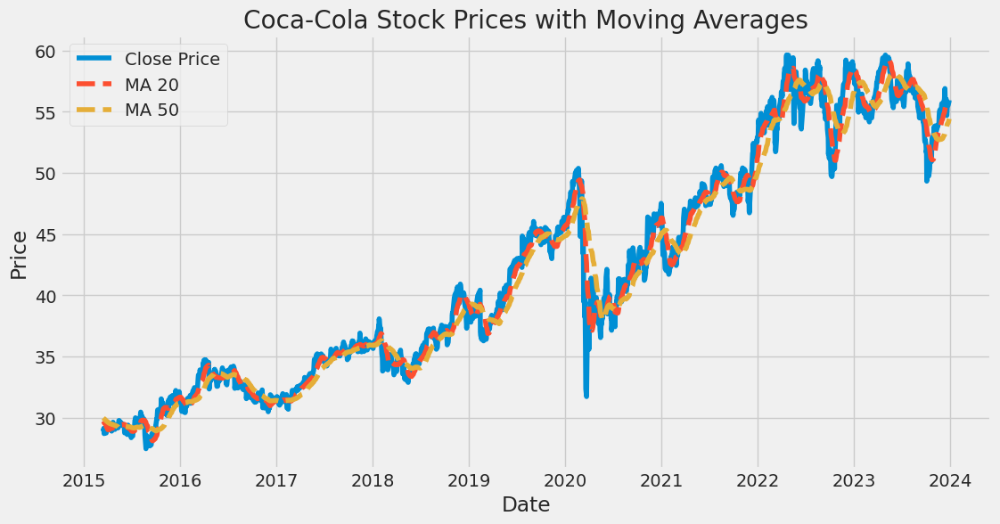

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Line plot for stock prices
plt.figure(figsize=(12, 6))
plt.plot(data['Date'], data['Close'], label='Close Price')
plt.plot(data['Date'], data['MA_20'], label='MA 20',
linestyle='--')
plt.plot(data['Date'], data['MA_50'], label='MA 50',
linestyle='--')
plt.title('Coca-Cola Stock Prices with Moving Averages')
plt.xlabel('Date')

plt.ylabel('Price')
plt.legend()
plt.show()

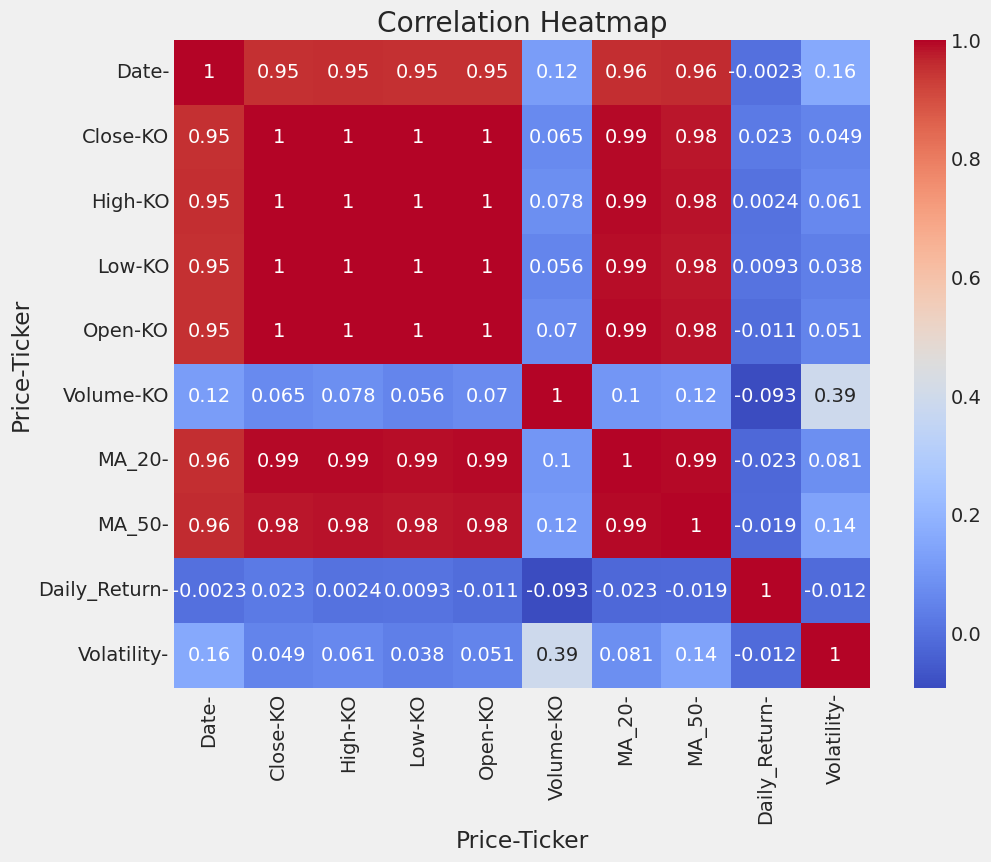

In [ ]:
# Correlation heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(data.corr(), annot=True, cmap='coolwarm')
plt.title('Correlation Heatmap')
plt.show()

In [ ]:
from sklearn.model_selection import train_test_split

# Select only existing columns
features = ['Open', 'High', 'Low', 'Volume', 'Dividends',
            'Stock Splits', 'MA_20', 'MA_50', 'Daily_Return', 'Volatility']
target = 'Close'

# Filter features to avoid KeyError
features = [col for col in features if col in data.columns]

# Check if target column exists
if target not in data.columns:
    raise KeyError(f"Target column '{target}' not found in dataset!")

# Prepare data
X = data[features]
y = data[target]

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42, shuffle=False
)


In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error

# Initialize the model
model = RandomForestRegressor(n_estimators=100,
random_state=42)

# Train the model
model.fit(X_train, y_train)

# Predict on test set
y_pred = model.predict(X_test)

# Evaluate model
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)

print(f"Mean Squared Error: {mse}")
print(f"Mean Absolute Error: {mae}")

Mean Squared Error: 2.5664588270723807
Mean Absolute Error: 1.1534940016942425


In [ ]:
# Fetch latest stock data
live_data = yf.download(ticker, period='1d', interval='1m')

# Prepare live data for prediction
live_data['MA_20'] = live_data['Close'].rolling(window=20).mean()
live_data['MA_50'] = live_data['Close'].rolling(window=50).mean()

live_data['Daily_Return'] = live_data['Close'].pct_change()
live_data['Volatility'] = live_data['Daily_Return'].rolling(window=20).std()

# Ensure no missing values
live_data.fillna(0, inplace=True)

# Use the latest data point for prediction
latest_features = live_data[features].iloc[-1:].dropna()
live_prediction = model.predict(latest_features)

print(f"Predicted Closing Price: {live_prediction[0]}")

[*********************100%***********************]  1 of 1 completed

Predicted Closing Price: 55.72743110656738


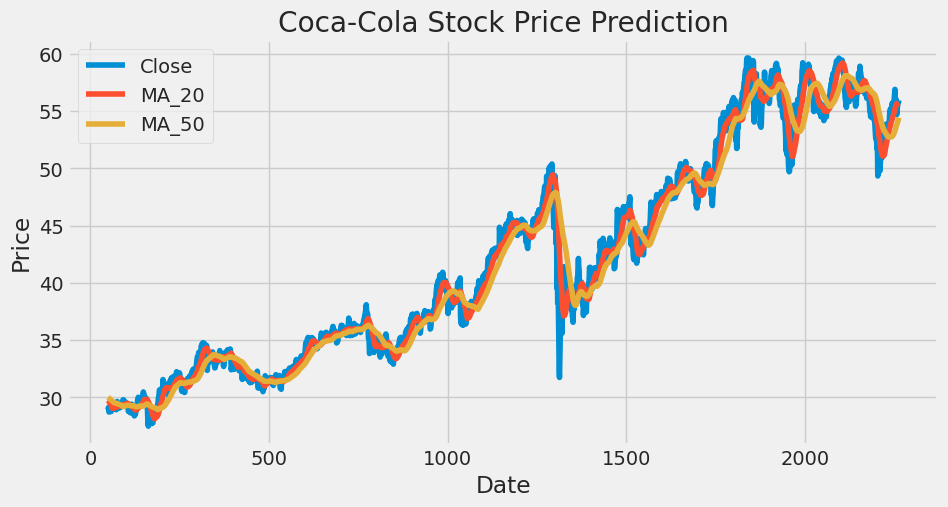

Predicted Closing Price: 55.72743110656738


In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10,5))
plt.plot(data['Close'], label='Close')
plt.plot(data['MA_20'], label='MA_20')
plt.plot(data['MA_50'], label='MA_50')
plt.title('Coca-Cola Stock Price Prediction')
plt.xlabel('Date')
plt.ylabel('Price')
plt.legend()
plt.show()

print(f"Predicted Closing Price: {live_prediction[0]}")


In [ ]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('whitegrid')
plt.style.use("fivethirtyeight")
%matplotlib inline

# For reading stock data from yahoo
from pandas_datareader.data import DataReader

# For time stamps
from datetime import datetime
from math import sqrt
from math import sqrt

from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler

In [ ]:
#ignore the warnings
import warnings
warnings.filterwarnings('ignore')

In [ ]:
# Loading Dataset
KO_Data = pd.read_csv('/content/Coca-Cola_stock_history (2).csv')

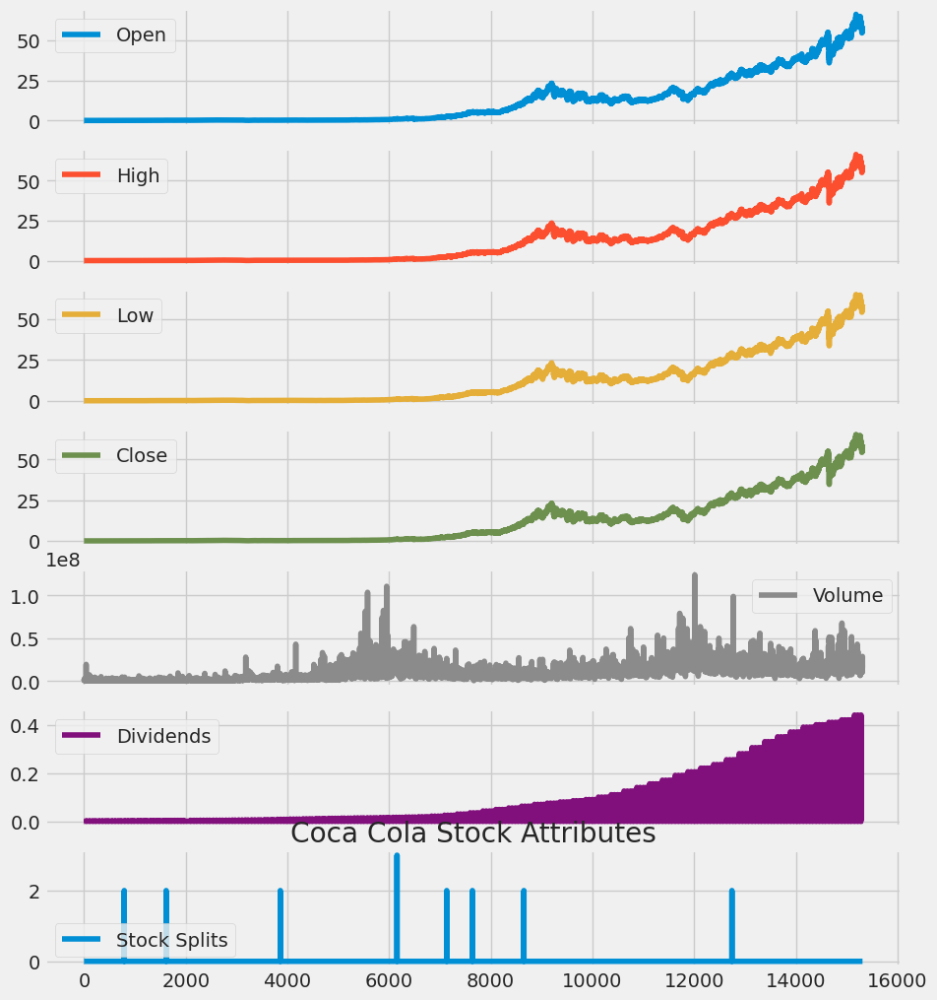

In [ ]:
KO_Data.plot(subplots = True, figsize = (10,12))
plt.title('Coca Cola Stock Attributes')
plt.show()

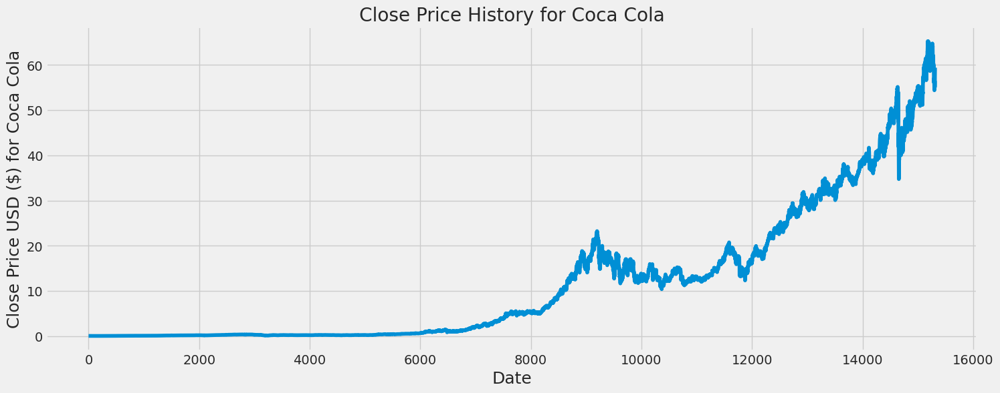

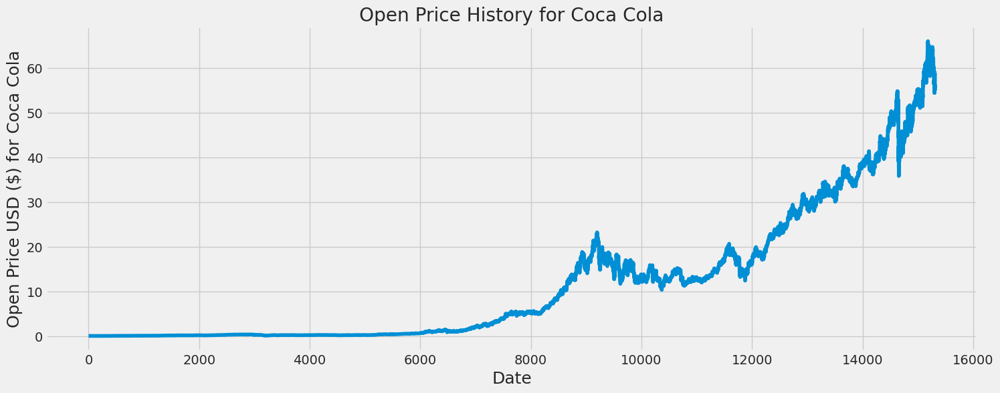

In [ ]:
def plot_close_val(data_frame, column, stock):
  plt.figure(figsize=(16,6))

  plt.title(column + ' Price History for ' + stock )
  plt.plot(data_frame[column])
  plt.xlabel('Date', fontsize=18)
  plt.ylabel(column + ' Price USD ($) for ' + stock,fontsize=18)
  plt.show()

#Test the function
plot_close_val(KO_Data, 'Close', 'Coca Cola')
plot_close_val(KO_Data, 'Open', 'Coca Cola')



<Axes: >

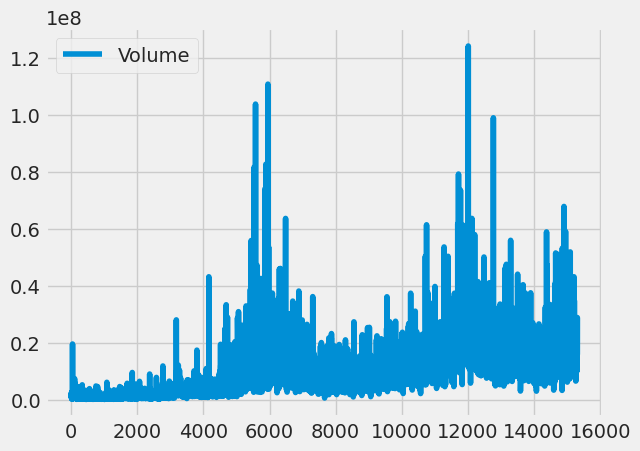

In [ ]:
KO_Data[["Volume"]].plot()

In [ ]:
import pandas as pd

# Load basic company info CSV
ko_info = pd.read_csv('/content/Coca-Cola_stock_history (2).csv',
    header=None,
    names=['Description', 'Information']
)

# Clean data
ko_info.dropna(inplace=True)
ko_info = ko_info[ko_info['Information'] != 'nan']

# Sort by 'Information' column
ko = ko_info.sort_values('Information')

# Display nicely
ko.style.set_properties(**{'text-align': 'left'})


In [ ]:
adj_close_px = KO_Data['Close']

# Calculate the moving average
moving_avg = adj_close_px.rolling(window=40).mean()

# Inspect the result
moving_avg[-10:]


,Close
15301,59.573229
15302,59.329031
15303,59.103823
15304,58.921440
15305,58.725320
15306,58.504966
15307,58.298918
15308,58.171838
15309,58.088689
15310,58.030935


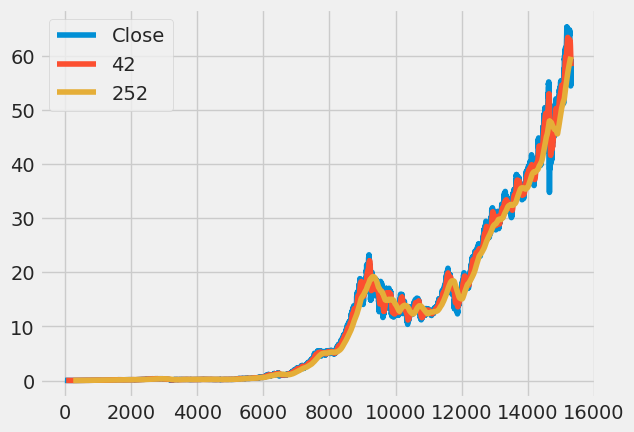

In [ ]:
# Short moving window rolling mean
KO_Data['42'] = adj_close_px.rolling(window=40).mean()

# Long moving window rolling mean
KO_Data['252'] = adj_close_px.rolling(window=252).mean()

# Plot the adjusted closing price, the short and long windows of rolling means
KO_Data[['Close', '42', '252']].plot()

plt.show()

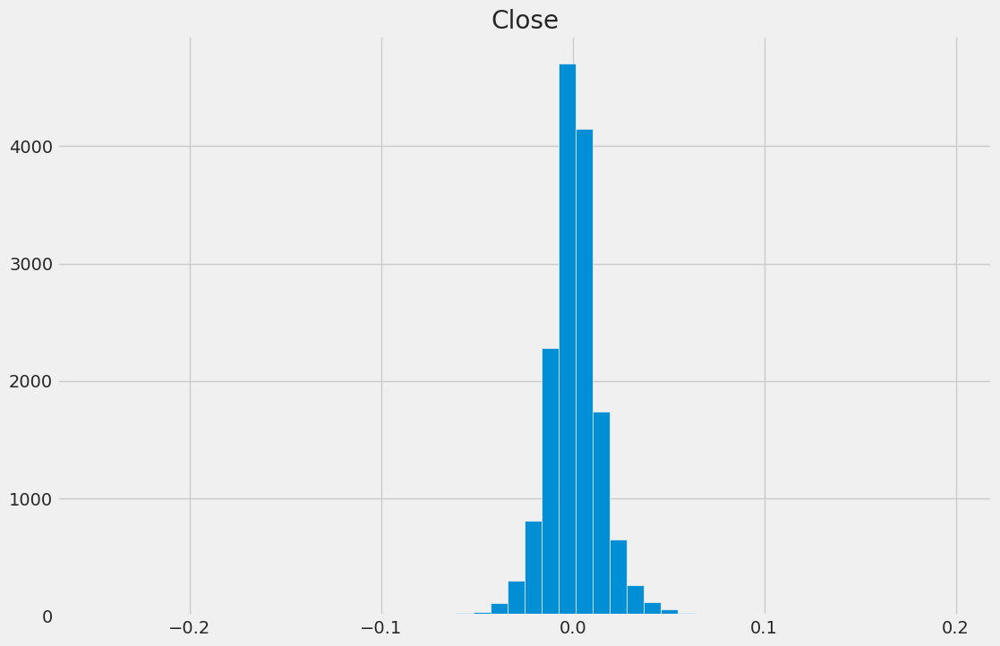

In [ ]:
daily_close_px = KO_Data[['Close']]
# Calculate the daily percentage change for `daily_close_px`
daily_pct_change = daily_close_px.pct_change()

# Plot the distributions
daily_pct_change.hist(bins=50, sharex=True, figsize=(12,8))

# Show the resulting plot
plt.show()


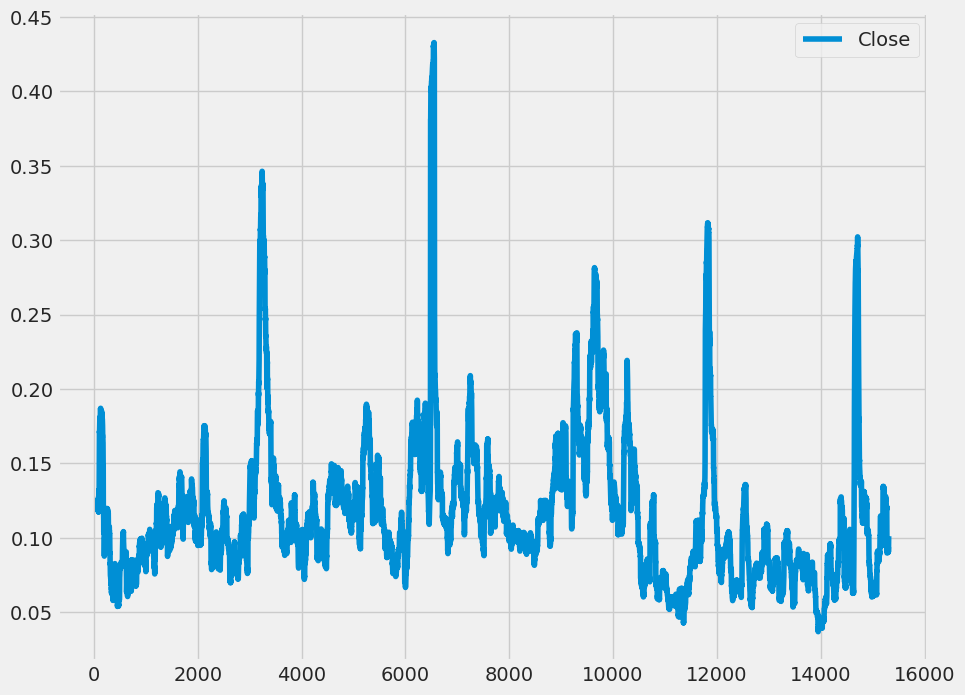

In [ ]:
# Define the minumum of periods to consider
min_periods = 75

# Calculate the volatility
vol = daily_pct_change.rolling(min_periods).std() * np.sqrt(min_periods)

# Plot the volatility
vol.plot(figsize=(10, 8))

# Show the plot
plt.show()

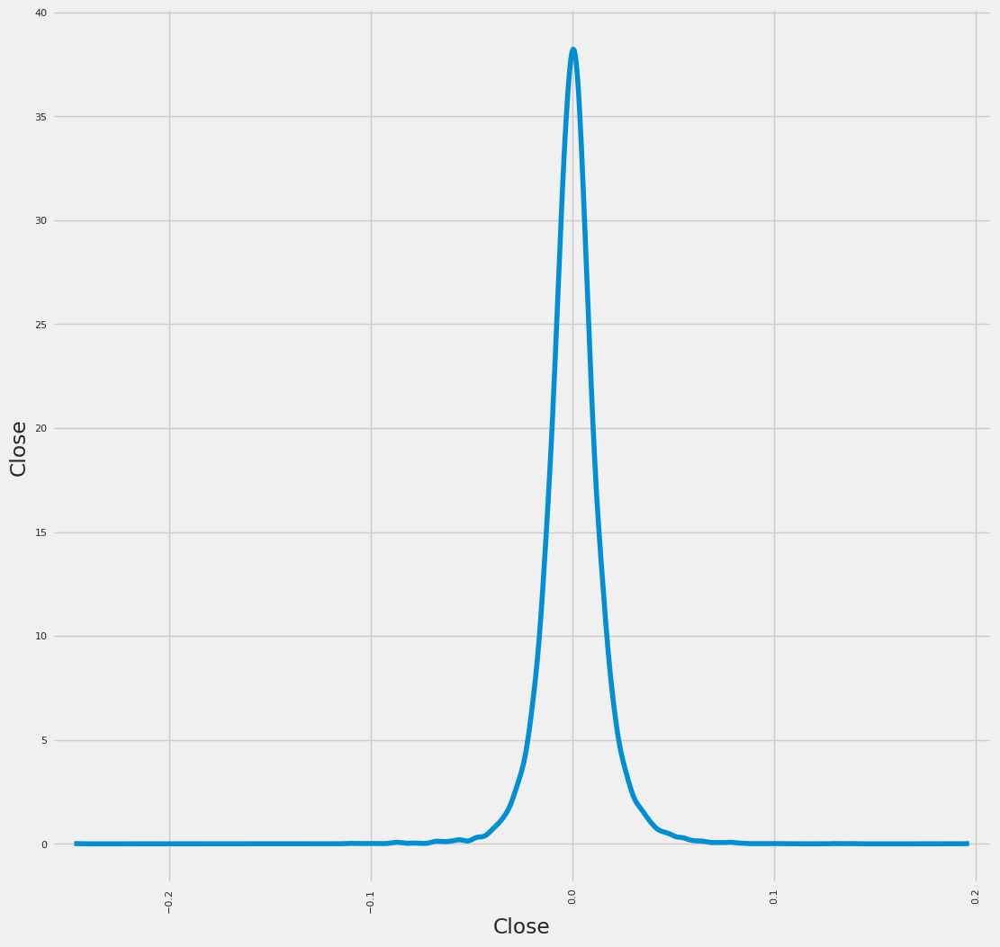

In [ ]:
# Plot a scatter matrix with the `daily_pct_change` data
pd.plotting.scatter_matrix(daily_pct_change, diagonal='kde',
alpha=0.1,figsize=(12,12))

# Show the plot
plt.show()

In [ ]:
import plotly.graph_objects as go

KO_Data=KO_Data.reset_index()

fig = go.Figure(data=go.Ohlc(x=KO_Data['Date'],

open=KO_Data['Open'],
high=KO_Data['High'],
low=KO_Data['Low'],
close=KO_Data['Close']))

fig.show()

In [ ]:
#KO_Data=KO_Data.reset_index()

KO_Data['SMA5'] = KO_Data.Close.rolling(5).mean()
KO_Data['SMA20'] = KO_Data.Close.rolling(20).mean()
KO_Data['SMA50'] = KO_Data.Close.rolling(50).mean()
KO_Data['SMA200'] = KO_Data.Close.rolling(200).mean()
KO_Data['SMA500'] = KO_Data.Close.rolling(500).mean()

fig = go.Figure(data=[go.Ohlc(x=KO_Data['Date'],open=KO_Data['Open'],
high=KO_Data['High'],low=KO_Data['Low'],close=KO_Data['Close'],
name = "OHLC"),

go.Scatter(x=KO_Data.Date,
y=KO_Data.SMA5, line=dict(color='orange', width=1),
name="SMA5"),

go.Scatter(x=KO_Data.Date,
y=KO_Data.SMA20, line=dict(color='green', width=1),
name="SMA20"),

go.Scatter(x=KO_Data.Date,
y=KO_Data.SMA50, line=dict(color='blue', width=1),
name="SMA50"),

go.Scatter(x=KO_Data.Date,
y=KO_Data.SMA200, line=dict(color='violet', width=1),
name="SMA200"),

go.Scatter(x=KO_Data.Date,
y=KO_Data.SMA500, line=dict(color='purple', width=1),
name="SMA500")])
fig.show()

In [ ]:
KO_Data['EMA5'] = KO_Data.Close.ewm(span=5,
adjust=False).mean()

KO_Data['EMA20'] = KO_Data.Close.ewm(span=20,
adjust=False).mean()
KO_Data['EMA50'] = KO_Data.Close.ewm(span=50,
adjust=False).mean()
KO_Data['EMA200'] = KO_Data.Close.ewm(span=200,
adjust=False).mean()
KO_Data['EMA500'] = KO_Data.Close.ewm(span=500,
adjust=False).mean()

fig = go.Figure(data=[go.Ohlc(x=KO_Data['Date'],
open=KO_Data['Open'],
high=KO_Data['High'],
low=KO_Data['Low'],
close=KO_Data['Close'], name =

"OHLC"),

go.Scatter(x=KO_Data.Date,
y=KO_Data.SMA5, line=dict(color='orange', width=1),
name="EMA5"),

go.Scatter(x=KO_Data.Date,
y=KO_Data.SMA20, line=dict(color='green', width=1),
name="EMA20"),

go.Scatter(x=KO_Data.Date,
y=KO_Data.SMA50, line=dict(color='blue', width=1),
name="EMA50"),

go.Scatter(x=KO_Data.Date,

y=KO_Data.SMA200, line=dict(color='violet', width=1),
name="EMA200"),

go.Scatter(x=KO_Data.Date,
y=KO_Data.SMA500, line=dict(color='purple', width=1),
name="EMA500")])
fig.show()

In [ ]:
KO_Data.head()
KO_Data.fillna(0)
KO_Data.set_index('Date')

,index,Open,High,Low,Close,Volume,Dividends,Stock Splits,42,252,SMA5,SMA20,SMA50,SMA200,SMA500,EMA5,EMA20,EMA50,EMA200,EMA500
Date,,,,,,,,,,,,,,,,,,,,
1962-01-02,0,0.050016,0.051378,0.050016,0.050016,806400,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.050016,0.050016,0.050016,0.050016,0.050016
1962-01-03,1,0.049273,0.049273,0.048159,0.048902,1574400,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.049644,0.049910,0.049972,0.050005,0.050011
1962-01-04,2,0.049026,0.049645,0.049026,0.049273,844800,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.049521,0.049849,0.049945,0.049998,0.050009
1962-01-05,3,0.049273,0.049892,0.048035,0.048159,1420800,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.049067,0.049688,0.049875,0.049979,0.050001
1962-01-08,4,0.047787,0.047787,0.046735,0.047664,2035200,0.0,0,NaN,NaN,0.048803,NaN,NaN,NaN,NaN,0.048599,0.049495,0.049788,0.049956,0.049992
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-10-20 00:00:00-04:00,15306,55.770000,55.919998,54.959999,55.080002,16905100,0.0,0,58.504966,59.684123,55.630000,55.9830,59.601667,60.938021,55.381488,55.558888,56.379974,58.482447,59.573558,56.052276
2022-10-21 00:00:00-04:00,15307,55.000000,56.110001,54.990002,55.959999,15028000,0.0,0,58.298918,59.696847,55.825999,55.8510,59.465619,60.920512,55.399508,55.692592,56.339976,58.383527,59.537602,56.051907
2022-10-24 00:00:00-04:00,15308,56.639999,57.730000,56.570000,57.570000,17416700,0.0,0,58.171838,59.715574,56.202000,55.8360,59.352240,60.912617,55.424399,56.318394,56.457121,58.351624,59.518024,56.057967


In [ ]:
try:
  from finta import TA
  from backtesting import Backtest, Strategy
  from backtesting.lib import crossover
except:
  !pip install finta backtesting
  from finta import TA
  from backtesting import Backtest, Strategy
  from backtesting.lib import crossover

In [ ]:
fin_ma = pd.read_csv('/content/Coca-Cola_stock_history (2).csv', parse_dates=True)
print(fin_ma.head())
ohlc=fin_ma
print(TA.SMA(ohlc, 42))
#ohlc.index = ohlc[index].dt.date

         Date      Open      High       Low     Close   Volume  Dividends  \
0  1962-01-02  0.050016  0.051378  0.050016  0.050016   806400        0.0   
1  1962-01-03  0.049273  0.049273  0.048159  0.048902  1574400        0.0   
2  1962-01-04  0.049026  0.049645  0.049026  0.049273   844800        0.0   
3  1962-01-05  0.049273  0.049892  0.048035  0.048159  1420800        0.0   
4  1962-01-08  0.047787  0.047787  0.046735  0.047664  2035200        0.0   

   Stock Splits  
0             0  
1             0  
2             0  
3             0  
4             0  
0              NaN
1              NaN
2              NaN
3              NaN
4              NaN
           ...    
15306    58.759467
15307    58.572686
15308    58.422110
15309    58.297065
15310    58.219369
Name: 42 period SMA, Length: 15311, dtype: float64


Running: TA.SMA(ohlc).plot(title='Simple Moving Average for Coca Cola / Coke Stock')
Running: TA.SMM(ohlc).plot(title='Simple Moving Median for Coca Cola / Coke Stock')
Running: TA.SSMA(ohlc).plot(title='Smoothed Simple Moving Average for Coca Cola / Coke Stock')
Running: TA.EMA(ohlc).plot(title='Exponential Moving Average for Coca Cola / Coke Stock')
Running: TA.DEMA(ohlc).plot(title='Double Exponential Moving Average for Coca Cola / Coke Stock')
Running: TA.TEMA(ohlc).plot(title='Triple Exponential Moving Average for Coca Cola / Coke Stock')
Running: TA.TRIMA(ohlc).plot(title='Triangular Moving Average for Coca Cola / Coke Stock')
Running: TA.TRIX(ohlc).plot(title='Triple Exponential Moving Average Oscillator for Coca Cola / Coke Stock')
Running: TA.VAMA(ohlc).plot(title='Volume Adjusted Moving Average for Coca Cola / Coke Stock')
Running: TA.ER(ohlc).plot(title='Kaufman Efficiency Indicator for Coca Cola / Coke Stock')
Running: TA.KAMA(ohlc).plot(title='Kaufmans Adaptive Moving Aver

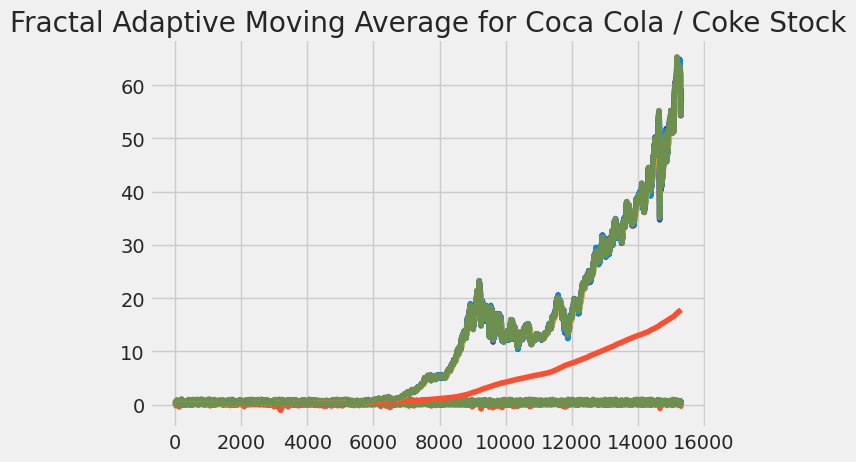

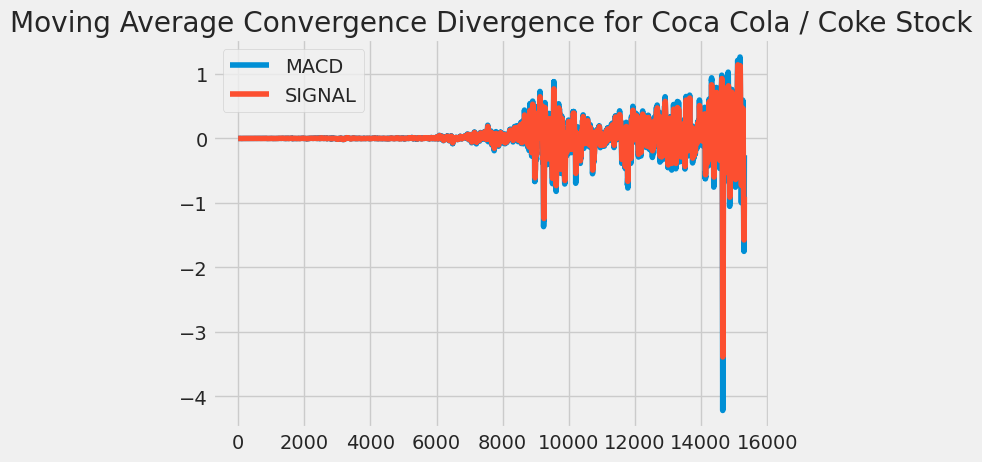

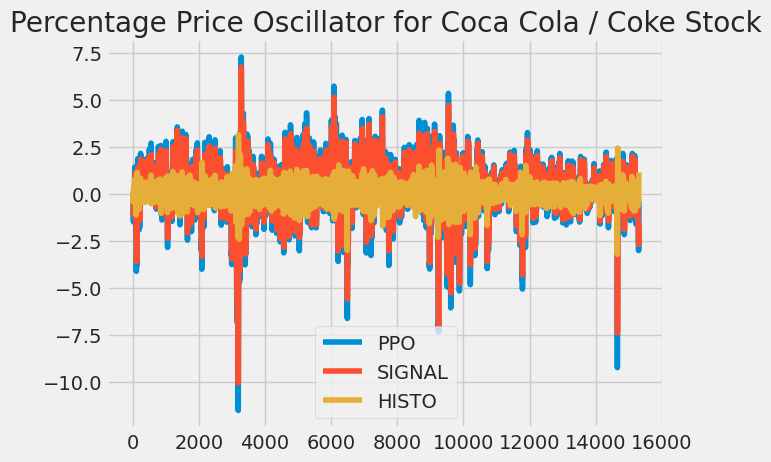

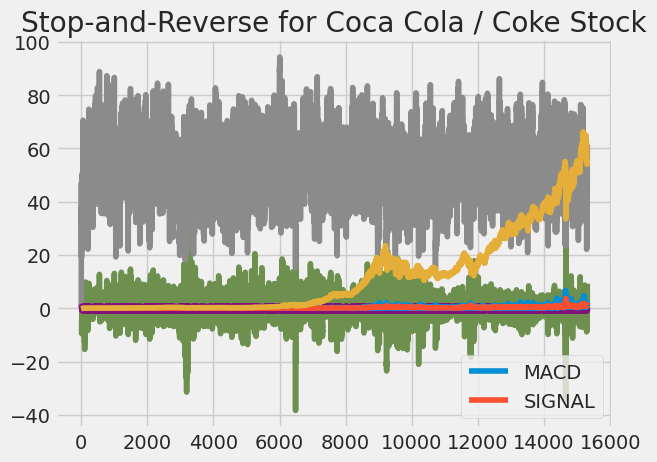

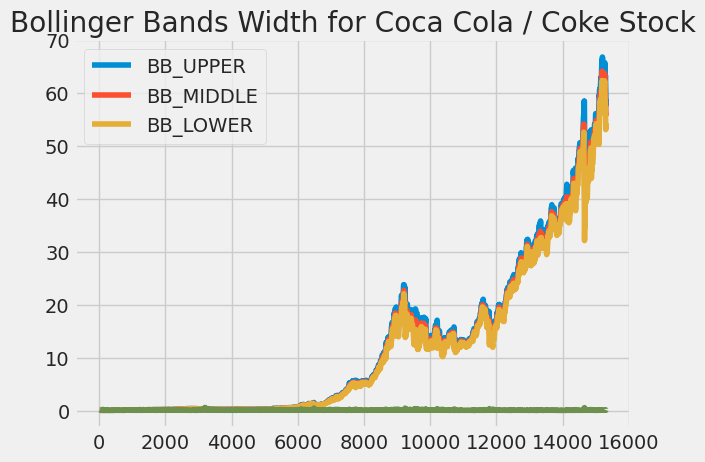

...

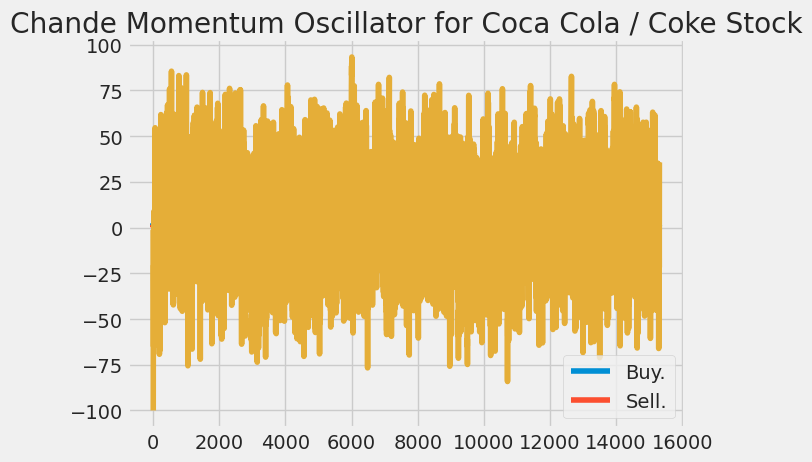

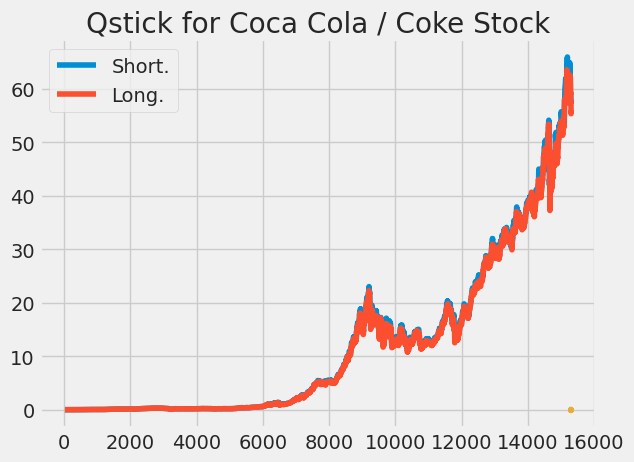

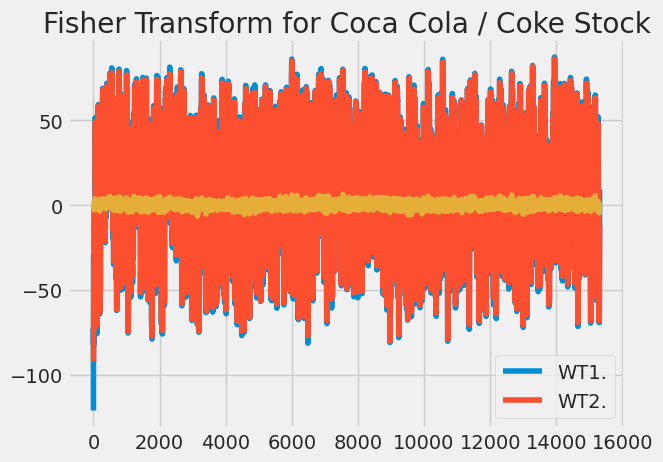

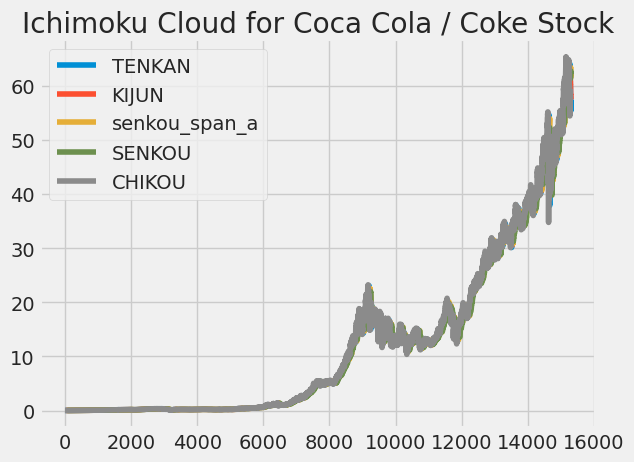

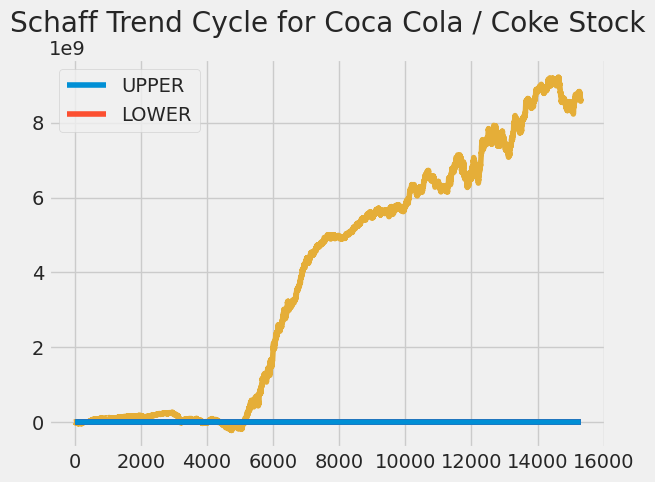

In [ ]:
# Dictionary of technical indicators
function_dict = {
    'Simple Moving Average': 'SMA',
    'Simple Moving Median': 'SMM',
    'Smoothed Simple Moving Average': 'SSMA',
    'Exponential Moving Average': 'EMA',
    'Double Exponential Moving Average': 'DEMA',
    'Triple Exponential Moving Average': 'TEMA',
    'Triangular Moving Average': 'TRIMA',
    'Triple Exponential Moving Average Oscillator': 'TRIX',
    'Volume Adjusted Moving Average': 'VAMA',
    'Kaufman Efficiency Indicator': 'ER',
    'Kaufmans Adaptive Moving Average': 'KAMA',
    'Zero Lag Exponential Moving Average': 'ZLEMA',
    'Weighted Moving Average': 'WMA',
    'Hull Moving Average': 'HMA',
    'Elastic Volume Moving Average': 'EVWMA',
    'Volume Weighted Average Price': 'VWAP',
    'Smoothed Moving Average': 'SMMA',
    'Fractal Adaptive Moving Average': 'FRAMA',
    'Moving Average Convergence Divergence': 'MACD',
    'Percentage Price Oscillator': 'PPO',
    'Volume-Weighted MACD': 'VW_MACD',
    'Elastic-Volume weighted MACD': 'EV_MACD',
    'Market Momentum': 'MOM',
    'Rate-of-Change': 'ROC',
    'Relative Strength Index': 'RSI',
    'Inverse Fisher Transform RSI': 'IFT_RSI',
    'True Range': 'TR',
    'Average True Range': 'ATR',
    'Stop-and-Reverse': 'SAR',
    'Bollinger Bands': 'BBANDS',
    'Bollinger Bands Width': 'BBWIDTH',
    'Momentum Breakout Bands': 'MOBO',
    'Percent B': 'PERCENT_B',
    'Keltner Channels': 'KC',
    'Donchian Channel': 'DO',
    'Directional Movement Indicator': 'DMI',
    'Average Directional Index': 'ADX',
    'Pivot Points': 'PIVOT',
    'Fibonacci Pivot Points': 'PIVOT_FIB',
    'Stochastic Oscillator Percent K': 'STOCH',
    'Stochastic oscillator Percent D': 'STOCHD',
    'Stochastic RSI': 'STOCHRSI',
    'Williams Percent R': 'WILLIAMS',
    'Ultimate Oscillator': 'UO',
    'Awesome Oscillator': 'AO',
    'Mass Index': 'MI',
    'Know Sure Thing': 'KST',
    'True Strength Index': 'TSI',
    'Typical Price': 'TP',
    'Accumulation-Distribution Line': 'ADL',
    'Chaikin Oscillator': 'CHAIKIN',
    'Money Flow Index': 'MFI',
    'On Balance Volume': 'OBV',
    'Weighter OBV': 'WOBV',
    'Volume Zone Oscillator': 'VZO',
    'Price Zone Oscillator': 'PZO',
    'Elders Force Index': 'EFI',
    'Cummulative Force Index': 'CFI',
    'Bull power and Bear Power': 'EBBP',
    'Ease of Movement': 'EMV',
    'Commodity Channel Index': 'CCI',
    'Coppock Curve': 'COPP',
    'Buy and Sell Pressure': 'BASP',
    'Normalized BASP': 'BASPN',
    'Chande Momentum Oscillator': 'CMO',
    'Chandelier Exit': 'CHANDELIER',
    'Qstick': 'QSTICK',
    'Wave Trend Oscillator': 'WTO',
    'Fisher Transform': 'FISH',
    'Ichimoku Cloud': 'ICHIMOKU',
    'Adaptive Price Zone': 'APZ',
    'Volume Price Trend': 'VPT',
    'Finite Volume Element': 'FVE',
    'Volume Flow Indicator': 'VFI',
    'Moving Standard deviation': 'MSD',
    'Schaff Trend Cycle': 'STC'
}

# Loop through each indicator and plot it
for key, value in function_dict.items():
    try:
        function_name = f"TA.{value}(ohlc).plot(title='{key} for Coca Cola / Coke Stock')"
        print(f"Running: {function_name}")
        result = eval(function_name)
    except Exception as e:
        print(f"⚠️ Error with {key}: {e}")


In [ ]:
# Defining DEMA cross strategy
class DemaCross(Strategy):

  def init(self):

    self.ma1 = self.I(TA.DEMA, ohlc, 10)
    self.ma2 = self.I(TA.DEMA, ohlc, 20)

  def next(self):
   if crossover(self.ma1, self.ma2):

      self.buy()
   elif crossover(self.ma2, self.ma1):
      self.sell()

In [ ]:
ohlc.head()
print(ohlc.Date)

0                       1962-01-02
1                       1962-01-03
2                       1962-01-04
3                       1962-01-05
4                       1962-01-08
                   ...            
15306    2022-10-20 00:00:00-04:00
15307    2022-10-21 00:00:00-04:00
15308    2022-10-24 00:00:00-04:00
15309    2022-10-25 00:00:00-04:00
15310    2022-10-26 00:00:00-04:00
Name: Date, Length: 15311, dtype: object


In [ ]:
bt = Backtest(ohlc, DemaCross,

cash=100000, commission=0.015,

exclusive_orders=True)

In [ ]:
bt.run()

Backtest.run:   0%|          | 0/15310 [00:00<?, ?bar/s]

,0
Start,0.0
End,15310.0
Duration,15310.0
Exposure Time [%],26.882633
Equity Final [$],0.190414
Equity Peak [$],100000.0
Commissions [$],77449.51548
Return [%],-99.99981
Buy & Hold Return [%],118642.19364
Return (Ann.) [%],0.0


In [ ]:
bt.plot()

GridPlot(id='p2723', ...)

In [ ]:
data=ohlc

In [ ]:
from backtesting import Strategy
from backtesting.lib import crossover
from backtesting.test import SMA

In [94]:
def BBANDS(data, n_lookback, n_std):
  print("""Bollinger bands indicator""")
  hlc3 = (data.High + data.Low + data.Close) / 3
  mean, std = hlc3.rolling(n_lookback).mean(),

  hlc3.rolling(n_lookback).std()
  upper = mean + n_std*std
  lower = mean - n_std*std
  return upper, lower

  close = data.Close.values
  sma10 = SMA(data.Close, 10)
  sma20 = SMA(data.Close, 20)
  sma50 = SMA(data.Close, 50)
  sma100 = SMA(data.Close, 100)
  upper, lower = BBANDS(data, 20, 2)

# Design matrix / independent features:

# Price-derived features
  data['X_SMA10'] = (close - sma10) / close
  data['X_SMA20'] = (close - sma20) / close
  data['X_SMA50'] = (close - sma50) / close
  data['X_SMA100'] = (close - sma100) / close

  data['X_DELTA_SMA10'] = (sma10 - sma20) / close
  data['X_DELTA_SMA20'] = (sma20 - sma50) / close
  data['X_DELTA_SMA50'] = (sma50 - sma100) / close

# Indicator features
  data['X_MOM'] = data.Close.pct_change(periods=2)
  data['X_BB_upper'] = (upper - close) / close
  data['X_BB_lower'] = (lower - close) / close
  data['X_BB_width'] = (upper - lower) / close
#data['X_Sentiment'] =
  ~data.index.to_series().between('2017-09-27', '2017-12-14')



In [95]:
class Sma4Cross(Strategy):
  n1 = 50

  n2 = 100
  n_enter = 20
  n_exit = 10

  def init(self):
    self.sma1 = self.I(SMA, self.data.Close, self.n1)
    self.sma2 = self.I(SMA, self.data.Close, self.n2)
    self.sma_enter = self.I(SMA, self.data.Close,

    self.n_enter)

    self.sma_exit = self.I(SMA, self.data.Close,

    self.n_exit)

  def next(self):

    if not self.position:

# On upwards trend, if price closes above
# "entry" MA, go long

# Here, even though the operands are arrays, this
# works by implicitly comparing the two last values
      if self.sma1 > self.sma2:
        if crossover(self.data.Close, self.sma_enter):
           self.buy()

# On downwards trend, if price closes below
# "entry" MA, go short

      else:
       if crossover(self.sma_enter, self.data.Close):
          self.sell()

# But if we already hold a position and the price
# closes back below (above) "exit" MA, close the position

       else:
          if (self.position.is_long and crossover(self.sma_exit, self.data.Close)
          or
          self.position.is_short and
          crossover(self.data.Close, self.sma_exit)):

            self.position.close()

Backtest.optimize:   0%|          | 0/97 [00:00<?, ?it/s]

Backtest.run:   0%|          | 0/2048 [00:00<?, ?bar/s]

Start                     2004-08-19 00:00:00
End                       2013-03-01 00:00:00
Duration                   3116 days 00:00:00
Exposure Time [%]                    91.29423
Equity Final [$]                  18487.47514
Equity Peak [$]                   25148.77304
Commissions [$]                    1493.91406
Return [%]                           84.87475
Buy & Hold Return [%]                313.3036
Return (Ann.) [%]                     7.47555
Volatility (Ann.) [%]                 30.8777
CAGR [%]                              5.09527
Sharpe Ratio                           0.2421
Sortino Ratio                         0.37148
Calmar Ratio                          0.13747
Alpha [%]                            61.32174
Beta                                  0.07518
Max. Drawdown [%]                   -54.38058
Avg. Drawdown [%]                    -6.42739
Max. Drawdown Duration     1374 days 00:00:00
Avg. Drawdown Duration       78 days 00:00:00
# Trades                          

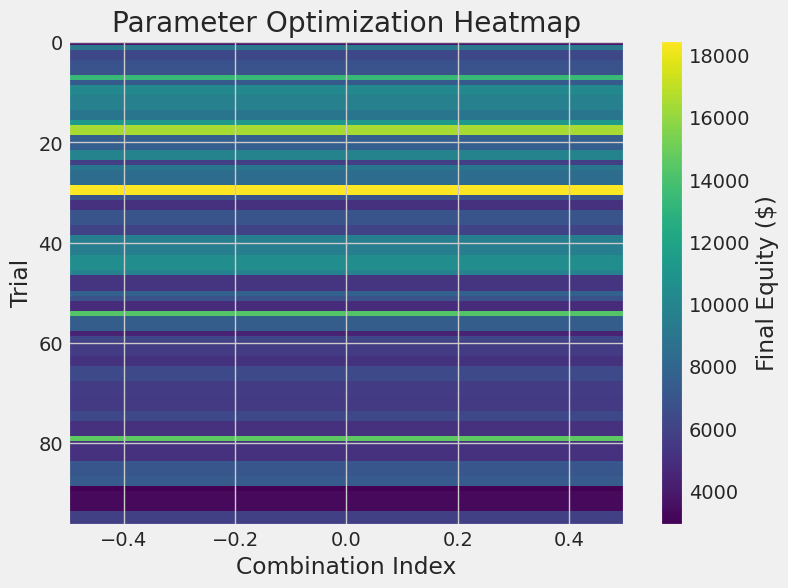

CPU times: user 3.34 s, sys: 393 ms, total: 3.74 s
Wall time: 14 s


In [97]:
%%time
!pip install backtesting --quiet

from backtesting import Backtest, Strategy
from backtesting.test import GOOG
from backtesting.lib import crossover
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt


class Sma4Cross(Strategy):
    n1 = 20
    n2 = 50
    n_enter = 25
    n_exit = 15

    def init(self):

        close = self.data.Close
        self.sma1 = self.I(lambda x: pd.Series(x).rolling(self.n1).mean(), close)
        self.sma2 = self.I(lambda x: pd.Series(x).rolling(self.n2).mean(), close)

    def next(self):
        # Buy when short SMA crosses above long SMA
        if crossover(self.sma1, self.sma2):
            self.buy()
        # Sell when short SMA crosses below long SMA
        elif crossover(self.sma2, self.sma1):
            self.sell()

bt = Backtest(GOOG, Sma4Cross, commission=.002, exclusive_orders=True)

stats, heatmap = bt.optimize(
    n1=range(10, 110, 10),
    n2=range(20, 210, 20),
    n_enter=range(15, 35, 5),
    n_exit=range(10, 25, 5),
    constraint=lambda p: p.n_exit < p.n_enter < p.n1 < p.n2,
    maximize='Equity Final [$]',
    max_tries=100,  # fewer tries to make it faster
    random_state=0,
    return_heatmap=True
)

print(stats)

bt.plot()


heatmap_df = pd.DataFrame(heatmap)
plt.figure(figsize=(8,6))
plt.imshow(heatmap_df.values, aspect='auto', cmap='viridis')
plt.colorbar(label='Final Equity ($)')
plt.title('Parameter Optimization Heatmap')
plt.xlabel('Combination Index')
plt.ylabel('Trial')
plt.show()


In [ ]:
hm = heatmap.groupby(['n1', 'n2']).mean().unstack()
hm

n2,40,60,80,100,120,140,160,180,200
n1,,,,,,,,,
20,NaN,NaN,3849.46684,9143.96388,NaN,NaN,NaN,NaN,NaN
30,6264.9858,6838.59174,6893.84030,13374.95322,NaN,NaN,7288.99024,10135.39816,9681.53244
40,NaN,8922.54194,NaN,11293.15816,16457.57680,NaN,7560.43122,9831.30246,5843.33694
50,NaN,8926.65794,8409.31366,18487.47514,NaN,6858.40430,5106.05856,6941.02306,6092.02074
60,NaN,NaN,9580.46998,10523.24238,9799.32560,5215.98174,7698.82088,6754.80998,4844.40194
70,NaN,NaN,14321.77758,NaN,7487.84018,4369.00052,6125.06446,5673.98720,5138.05684
80,NaN,NaN,NaN,6314.69182,5610.58574,5671.25396,5510.42244,6268.52550,5086.14116
90,NaN,NaN,NaN,14632.96932,5121.69494,7113.96908,NaN,7025.11392,NaN
100,NaN,NaN,NaN,NaN,7336.19250,2877.85568,3259.80976,5842.78950,NaN


In [ ]:
from backtesting.lib import plot_heatmaps

plot_heatmaps(heatmap, agg='mean')

GridPlot(id='p3409', ...)